# Data Mining on Food Recipes 
CISC 520 Final Project

Wusi Fan


- Dataset: Food Recipes and Interactions dataset crawled from Food.com and made available on [Kaggle.com](https://www.kaggle.com/shuyangli94/food-com-recipes-and-user-interactions#RAW_interactions.csv)
This dataset includes detailed data of recipes uploaded to Food.com, and customer ratings and reviews for those recipes.
    - https://www.kaggle.com/shuyangli94/food-com-recipes-and-user-interactions/version/2#RAW_recipes.csv

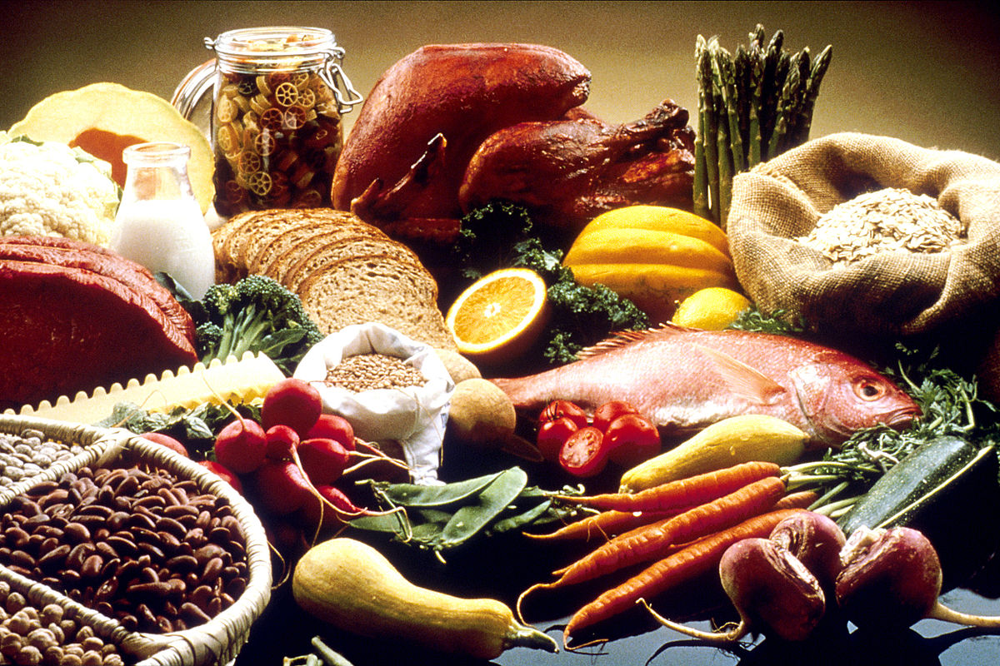

## Frequent Parttern Mining
##### Target: Apply the Frequent Parttern Mining method, explore if there is any refrequent patter in the 4 text-rich columns in the data:
- recipe name
- ingredients
- recipe tags



## Recipe Popularity Analysis:

##### Target: Apply regression and classification models, test if the Popularity of recipes can be forecasted with current available data.

#### Popularity Index
- Number of Reviews 7 days after upload, 30 days after upload, 365 days after upload

#### Feature Engineering
- Recipe Nutrition - Caloiro level
- Recipe Complexity (already included in data)
    - number of steps
    - minutes
    - number of ingredients
- Recipe Seasonality
    - Upload Month
    - Upload Day of Month
    - Upload Day of week
- Recipe Instruction
    - length of instruction 
    - LIX of Instruction
        -https://epjdatascience.springeropen.com/articles/10.1140/epjds/s13688-018-0149-5#Sec10
- Recipe Description
    - length of Title
    - Length of description
    - LIX of description
    - Sentiment of description



In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import datetime

## Raw Data
- a csv file contains all recipes uploaded Food.com between between Aug 5, 1999 and Dec 8, 2018
    - each row is a recipe that has a unique id, there are 231,637 record in the raw data.
    - columns are attributes of recipes

In [2]:
# Import recipe data file as a DataFrame
recipes_df = pd.read_csv("RAW_recipes.csv", encoding="utf-8")


## drop rows with NAN value
recipes_df_rm_na = recipes_df.dropna()


## convert submit date column to datetime format
recipes_df_rm_na.loc[:,'submitted']= pd.to_datetime(recipes_df_rm_na['submitted'])

## only include recipe uploaded before Dec 8, 2017 - so each recipe has to be uploaded at least for a year
recipes_df_rm_na = recipes_df_rm_na.loc[pd.DatetimeIndex(recipes_df_rm_na.loc[:,"submitted"]).year<2018,:]

recipes_df_rm_na.info()
recipes_df_rm_na.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 226468 entries, 0 to 231636
Data columns (total 12 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   name            226468 non-null  object        
 1   id              226468 non-null  int64         
 2   minutes         226468 non-null  int64         
 3   contributor_id  226468 non-null  int64         
 4   submitted       226468 non-null  datetime64[ns]
 5   tags            226468 non-null  object        
 6   nutrition       226468 non-null  object        
 7   n_steps         226468 non-null  int64         
 8   steps           226468 non-null  object        
 9   description     226468 non-null  object        
 10  ingredients     226468 non-null  object        
 11  n_ingredients   226468 non-null  int64         
dtypes: datetime64[ns](1), int64(5), object(6)
memory usage: 22.5+ MB


/opt/anaconda3/envs/py3/lib/python3.7/site-packages/pandas/core/indexing.py:964: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


,name,id,minutes,contributor_id,submitted,tags,nutrition,n_steps,steps,description,ingredients,n_ingredients
0,arriba baked winter squash mexican style,137739,55,47892,2005-09-16,"['60-minutes-or-less', 'time-to-make', 'course...","[51.5, 0.0, 13.0, 0.0, 2.0, 0.0, 4.0]",11,"['make a choice and proceed with recipe', 'dep...",autumn is my favorite time of year to cook! th...,"['winter squash', 'mexican seasoning', 'mixed ...",7
1,a bit different breakfast pizza,31490,30,26278,2002-06-17,"['30-minutes-or-less', 'time-to-make', 'course...","[173.4, 18.0, 0.0, 17.0, 22.0, 35.0, 1.0]",9,"['preheat oven to 425 degrees f', 'press dough...",this recipe calls for the crust to be prebaked...,"['prepared pizza crust', 'sausage patty', 'egg...",6
2,all in the kitchen chili,112140,130,196586,2005-02-25,"['time-to-make', 'course', 'preparation', 'mai...","[269.8, 22.0, 32.0, 48.0, 39.0, 27.0, 5.0]",6,"['brown ground beef in large pot', 'add choppe...",this modified version of 'mom's' chili was a h...,"['ground beef', 'yellow onions', 'diced tomato...",13
3,alouette potatoes,59389,45,68585,2003-04-14,"['60-minutes-or-less', 'time-to-make', 'course...","[368.1, 17.0, 10.0, 2.0, 14.0, 8.0, 20.0]",11,['place potatoes in a large pot of lightly sal...,"this is a super easy, great tasting, make ahea...","['spreadable cheese with garlic and herbs', 'n...",11
4,amish tomato ketchup for canning,44061,190,41706,2002-10-25,"['weeknight', 'time-to-make', 'course', 'main-...","[352.9, 1.0, 337.0, 23.0, 3.0, 0.0, 28.0]",5,['mix all ingredients& boil for 2 1 / 2 hours ...,my dh's amish mother raised him on this recipe...,"['tomato juice', 'apple cider vinegar', 'sugar...",8


# Frequent Pattern Mining

In [3]:
## define functions used to do Frequent Pattern Mining

def list2list (ls):
    ls2 = ls.strip("][").split(', ') 
    return ls2
def name2list (ls):
    ls2 = ls.strip("][").split(' ') 
    return ls2

### using the mlxtend package for Frequent Pattern Mining
    ### reference: ttp://rasbt.github.io/mlxtend/user_guide/frequent_patterns/fpgrowth/
def fpm (df,column_name,min_supt,split_func):
    ## convert data into correct format (list of lists)
    ls = df.loc[:,column_name].apply(split_func)
    ls = ls.tolist()
    #print(ls[0:10])
    
    ## create T/F table indicating weather an item appears each row
    from mlxtend.preprocessing import TransactionEncoder
    te = TransactionEncoder()
    te_ary = te.fit(ls).transform(ls)
    df2 = pd.DataFrame(te_ary, columns=te.columns_)
    
    
    ## return the items and itemsets with at least X% support:
    from mlxtend.frequent_patterns import apriori
    print(apriori(df2, min_support=min_supt, use_colnames=True).sort_values("support", ascending = False))



### 1. Frequent pattern of Ingredients
- Salt, butter, sugar are the top 3 ingredients used in all recipes, at no suprise
- Onion and garlic cloves appear to be very popular too
- There is only one two-item pattern have support over 10%, which is salt and butter

In [4]:
## frequent patter of Ingredients
fpm(recipes_df_rm_na,"ingredients",0.1,list2list)

     support            itemsets
7   0.369624            ('salt')
0   0.237323          ('butter')
8   0.191541           ('sugar')
6   0.168456           ('onion')
9   0.150277           ('water')
1   0.145800            ('eggs')
5   0.142219       ('olive oil')
2   0.113186           ('flour')
3   0.113040   ('garlic cloves')
4   0.111296            ('milk')
10  0.110360  ('salt', 'butter')


### 2. Frequent pattern of user tags
- Ideally, prequent patter of tag could be used for recommendating related tags for users based on their pre-entered tag
- However, it seems that the tags in the raw data was not perfectly splitted. For example, "60-minutes-or-less and "time-to-make" were treated as two seperate tags in the data, while they seems to be one tag splited into two. This problem cuases the frequent pattern mining result less meaningful and useful

In [6]:
## frequent patter of steps
fpm(recipes_df_rm_na,"tags",0.6,list2list)

     support                                           itemsets
3   0.995236                                    ('preparation')
4   0.972230                                   ('time-to-make')
13  0.972230                    ('preparation', 'time-to-make')
0   0.942531                                         ('course')
7   0.938667                          ('preparation', 'course')
8   0.917361                         ('course', 'time-to-make')
18  0.917361          ('preparation', 'course', 'time-to-make')
2   0.734607                                ('main-ingredient')
11  0.731887                 ('preparation', 'main-ingredient')
12  0.713549                ('time-to-make', 'main-ingredient')
20  0.713549  ('preparation', 'time-to-make', 'main-ingredie...
1   0.708157                                        ('dietary')
9   0.706374                         ('preparation', 'dietary')
6   0.697710                      ('course', 'main-ingredient')
16  0.695220       ('preparation', 'cour

### 3. Frequent pattern of recipe name
- Some of the words are meaningless, such as and, with 

In [31]:
## frequent patter of name
fpm(recipes_df_rm_na,"name",0.03,name2list)

     support     itemsets
0   0.178647           ()
1   0.131493        (and)
10  0.114163       (with)
4   0.102640    (chicken)
6   0.080420          (s)
7   0.061712      (salad)
3   0.042907     (cheese)
8   0.040870      (sauce)
9   0.040388       (soup)
5   0.036428  (chocolate)
2   0.033243       (cake)
11  0.032578  (with, and)


# Recipe Popularity Analysis:




## Part I. Feature engineering

### 1. Recipe Description
- Recipe Nutrition - Caloiro level

    The nutrition field in the raw data is unusable due to lack of documentation, however, the author of the dataset uploaded another data file that includes a Caloiro level, which can be mapped to the raw data file as representative of nutrition level.


In [5]:
## read caloiro data
caloiro_df = pd.read_csv("PP_recipes.csv", index_col = "id", encoding="utf-8") 

## map caloiro level to receipe table
recipes_df_rm_na.loc[:,"caloiro_level"]=recipes_df_rm_na.id.map(caloiro_df.loc[:,"calorie_level"])
recipes_df_rm_na.head()

,name,id,minutes,contributor_id,submitted,tags,nutrition,n_steps,steps,description,ingredients,n_ingredients,caloiro_level
0,arriba baked winter squash mexican style,137739,55,47892,2005-09-16,"['60-minutes-or-less', 'time-to-make', 'course...","[51.5, 0.0, 13.0, 0.0, 2.0, 0.0, 4.0]",11,"['make a choice and proceed with recipe', 'dep...",autumn is my favorite time of year to cook! th...,"['winter squash', 'mexican seasoning', 'mixed ...",7,0.0
1,a bit different breakfast pizza,31490,30,26278,2002-06-17,"['30-minutes-or-less', 'time-to-make', 'course...","[173.4, 18.0, 0.0, 17.0, 22.0, 35.0, 1.0]",9,"['preheat oven to 425 degrees f', 'press dough...",this recipe calls for the crust to be prebaked...,"['prepared pizza crust', 'sausage patty', 'egg...",6,0.0
2,all in the kitchen chili,112140,130,196586,2005-02-25,"['time-to-make', 'course', 'preparation', 'mai...","[269.8, 22.0, 32.0, 48.0, 39.0, 27.0, 5.0]",6,"['brown ground beef in large pot', 'add choppe...",this modified version of 'mom's' chili was a h...,"['ground beef', 'yellow onions', 'diced tomato...",13,NaN
3,alouette potatoes,59389,45,68585,2003-04-14,"['60-minutes-or-less', 'time-to-make', 'course...","[368.1, 17.0, 10.0, 2.0, 14.0, 8.0, 20.0]",11,['place potatoes in a large pot of lightly sal...,"this is a super easy, great tasting, make ahea...","['spreadable cheese with garlic and herbs', 'n...",11,1.0
4,amish tomato ketchup for canning,44061,190,41706,2002-10-25,"['weeknight', 'time-to-make', 'course', 'main-...","[352.9, 1.0, 337.0, 23.0, 3.0, 0.0, 28.0]",5,['mix all ingredients& boil for 2 1 / 2 hours ...,my dh's amish mother raised him on this recipe...,"['tomato juice', 'apple cider vinegar', 'sugar...",8,NaN


### 2. Recipe Seasonality

The time when a recipe is uploaded could potentially impact how much review it receives. For example, a receipe uploaded during weekend and holiday seasons might receive more views as more people are looking for cooking suggestion during that period.
- Upload Month
- Upload Day of Month
- Upload Day of week

In [6]:
## submit year
recipes_df_rm_na.loc[:,"submit_year"] = pd.DatetimeIndex(recipes_df_rm_na.loc[:,"submitted"]).year
## submit month
recipes_df_rm_na.loc[:,"submit_month"] = pd.DatetimeIndex(recipes_df_rm_na.loc[:,"submitted"]).month
## submit day of month
recipes_df_rm_na.loc[:,"day_of_month"] = pd.DatetimeIndex(recipes_df_rm_na.loc[:,"submitted"]).day
## submit day of week
recipes_df_rm_na.loc[:,'day_of_week'] =  recipes_df_rm_na.loc[:,'submitted'].dt.to_period('D').dt.dayofweek

recipes_df_rm_na.head()

,name,id,minutes,contributor_id,submitted,tags,nutrition,n_steps,steps,description,ingredients,n_ingredients,caloiro_level,submit_year,submit_month,day_of_month,day_of_week
0,arriba baked winter squash mexican style,137739,55,47892,2005-09-16,"['60-minutes-or-less', 'time-to-make', 'course...","[51.5, 0.0, 13.0, 0.0, 2.0, 0.0, 4.0]",11,"['make a choice and proceed with recipe', 'dep...",autumn is my favorite time of year to cook! th...,"['winter squash', 'mexican seasoning', 'mixed ...",7,0.0,2005,9,16,4
1,a bit different breakfast pizza,31490,30,26278,2002-06-17,"['30-minutes-or-less', 'time-to-make', 'course...","[173.4, 18.0, 0.0, 17.0, 22.0, 35.0, 1.0]",9,"['preheat oven to 425 degrees f', 'press dough...",this recipe calls for the crust to be prebaked...,"['prepared pizza crust', 'sausage patty', 'egg...",6,0.0,2002,6,17,0
2,all in the kitchen chili,112140,130,196586,2005-02-25,"['time-to-make', 'course', 'preparation', 'mai...","[269.8, 22.0, 32.0, 48.0, 39.0, 27.0, 5.0]",6,"['brown ground beef in large pot', 'add choppe...",this modified version of 'mom's' chili was a h...,"['ground beef', 'yellow onions', 'diced tomato...",13,NaN,2005,2,25,4
3,alouette potatoes,59389,45,68585,2003-04-14,"['60-minutes-or-less', 'time-to-make', 'course...","[368.1, 17.0, 10.0, 2.0, 14.0, 8.0, 20.0]",11,['place potatoes in a large pot of lightly sal...,"this is a super easy, great tasting, make ahea...","['spreadable cheese with garlic and herbs', 'n...",11,1.0,2003,4,14,0
4,amish tomato ketchup for canning,44061,190,41706,2002-10-25,"['weeknight', 'time-to-make', 'course', 'main-...","[352.9, 1.0, 337.0, 23.0, 3.0, 0.0, 28.0]",5,['mix all ingredients& boil for 2 1 / 2 hours ...,my dh's amish mother raised him on this recipe...,"['tomato juice', 'apple cider vinegar', 'sugar...",8,NaN,2002,10,25,4


In [7]:
recipes_df_rm_na.describe()

,id,minutes,contributor_id,n_steps,n_ingredients,caloiro_level,submit_year,submit_month,day_of_month,day_of_week
count,226468.000000,2.264680e+05,2.264680e+05,226468.000000,226468.000000,174263.000000,226468.000000,226468.000000,226468.000000,226468.000000
mean,225838.922704,9.610381e+03,4.990881e+06,9.766567,9.051583,0.862673,2006.485548,6.299667,15.583177,2.395407
std,139573.868793,4.512597e+06,9.411286e+07,5.983915,3.739017,0.790921,2.910321,3.429134,8.818317,1.905173
min,38.000000,0.000000e+00,2.700000e+01,0.000000,1.000000,0.000000,1999.000000,1.000000,1.000000,0.000000
25%,105629.250000,2.000000e+01,5.810400e+04,6.000000,6.000000,0.000000,2004.000000,3.000000,8.000000,1.000000
50%,211792.500000,4.000000e+01,1.804010e+05,9.000000,9.000000,1.000000,2007.000000,6.000000,15.000000,2.000000
75%,336376.250000,6.500000e+01,4.084540e+05,12.000000,11.000000,2.000000,2008.000000,9.000000,23.000000,4.000000
max,534760.000000,2.147484e+09,2.001852e+09,145.000000,43.000000,2.000000,2017.000000,12.000000,31.000000,6.000000


In [8]:
## Check out how many recipes are submitted by year
recipes_df_rm_na.groupby("submit_year")["id"].count()

submit_year
1999     1104
2000      580
2001     4065
2002    18262
2003    17106
2004    16505
2005    23819
2006    27230
2007    34275
2008    30724
2009    22509
2010    11896
2011     7567
2012     5187
2013     3792
2014     1049
2015      306
2016      204
2017      288
Name: id, dtype: int64

### 3. Recipe Instruction

The complexity may impact people's willingness to read and follow an instruction, and therefore change the likelyhood of a recipe receive reviews.
- Length of instruction 
- LIX of Instruction
    - LIX is a measue of Readability, on a scale from 0 to 100, the higher the score is, the less readable the text is. it can be computed based on the formula below:
    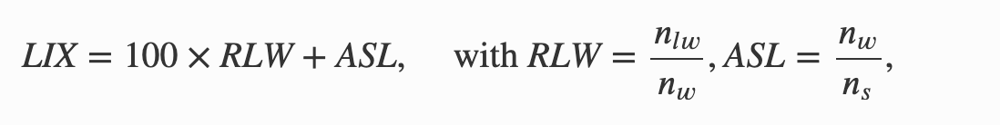
        - 𝑛𝑙𝑤 is the number of long words (words>6 characters)
        - 𝑛𝑤 is the word count
        - 𝑛𝑠 is the sentences count
        
    Reference: Christoph Trattner et, al. 2018 https://epjdatascience.springeropen.com/articles/10.1140/epjds/s13688-018-0149-5#Sec10



In [9]:
## length of instruction
recipes_df_rm_na.loc[:,"instruction_length"] = recipes_df_rm_na.loc[:,'steps'].apply(len)

## LIX of instruction
    ### create a function to calculate LIX:
def lix(text):
    nw = len(text.split()) 
    nlw = len([len(i) for i in text.split() if len(i)>6])
    ns = len(text.split(","))
    
    try:
        rlw = nlw/nw
        asl = nw/ns
        lix = 100* rlw+asl
    
        return lix

    except:
        return np.nan
        
    ### calculate LIX of instruction
recipes_df_rm_na.loc[:,"instruction_lix"] = recipes_df_rm_na.loc[:,'steps'].apply(lix)


recipes_df_rm_na.head()

,name,id,minutes,contributor_id,submitted,tags,nutrition,n_steps,steps,description,ingredients,n_ingredients,caloiro_level,submit_year,submit_month,day_of_month,day_of_week,instruction_length,instruction_lix
0,arriba baked winter squash mexican style,137739,55,47892,2005-09-16,"['60-minutes-or-less', 'time-to-make', 'course...","[51.5, 0.0, 13.0, 0.0, 2.0, 0.0, 4.0]",11,"['make a choice and proceed with recipe', 'dep...",autumn is my favorite time of year to cook! th...,"['winter squash', 'mexican seasoning', 'mixed ...",7,0.0,2005,9,16,4,731,25.128824
1,a bit different breakfast pizza,31490,30,26278,2002-06-17,"['30-minutes-or-less', 'time-to-make', 'course...","[173.4, 18.0, 0.0, 17.0, 22.0, 35.0, 1.0]",9,"['preheat oven to 425 degrees f', 'press dough...",this recipe calls for the crust to be prebaked...,"['prepared pizza crust', 'sausage patty', 'egg...",6,0.0,2002,6,17,0,414,29.666667
2,all in the kitchen chili,112140,130,196586,2005-02-25,"['time-to-make', 'course', 'preparation', 'mai...","[269.8, 22.0, 32.0, 48.0, 39.0, 27.0, 5.0]",6,"['brown ground beef in large pot', 'add choppe...",this modified version of 'mom's' chili was a h...,"['ground beef', 'yellow onions', 'diced tomato...",13,NaN,2005,2,25,4,312,23.712121
3,alouette potatoes,59389,45,68585,2003-04-14,"['60-minutes-or-less', 'time-to-make', 'course...","[368.1, 17.0, 10.0, 2.0, 14.0, 8.0, 20.0]",11,['place potatoes in a large pot of lightly sal...,"this is a super easy, great tasting, make ahea...","['spreadable cheese with garlic and herbs', 'n...",11,1.0,2003,4,14,0,577,35.810606
4,amish tomato ketchup for canning,44061,190,41706,2002-10-25,"['weeknight', 'time-to-make', 'course', 'main-...","[352.9, 1.0, 337.0, 23.0, 3.0, 0.0, 28.0]",5,['mix all ingredients& boil for 2 1 / 2 hours ...,my dh's amish mother raised him on this recipe...,"['tomato juice', 'apple cider vinegar', 'sugar...",8,NaN,2002,10,25,4,305,23.071429


### 4. Recipe Description

Similar to instruction, the complexity of recipe name, description may have influence on how likely a recipe receive views.
- Length of Title
- Length of description
- LIX of description
- Sentiment of description


In [10]:
## length of title
recipes_df_rm_na.loc[:,"title_length"] = recipes_df_rm_na.loc[:,'name'].apply(len)
## length of description
recipes_df_rm_na.loc[:,"description_length"] = recipes_df_rm_na.loc[:,'description'].apply(len)

## LIX of description
recipes_df_rm_na.loc[:,"description_lix"] = recipes_df_rm_na.loc[:,'description'].apply(lix)

## Sentiment of description   
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
    ### define a formula to calculated sentimental score
def senti(text):
    analyzer = SentimentIntensityAnalyzer()
    senti_score = analyzer.polarity_scores(text)["compound"]
    return senti_score
    ### calculate sentimental score of description
recipes_df_rm_na.loc[:,"description_senti"] = recipes_df_rm_na.loc[:,'description'].apply(senti)

recipes_df_rm_na.head()


,name,id,minutes,contributor_id,submitted,tags,nutrition,n_steps,steps,description,...,caloiro_level,submit_year,submit_month,day_of_month,day_of_week,instruction_length,instruction_lix,title_length,description_length,description_lix
0,arriba baked winter squash mexican style,137739,55,47892,2005-09-16,"['60-minutes-or-less', 'time-to-make', 'course...","[51.5, 0.0, 13.0, 0.0, 2.0, 0.0, 4.0]",11,"['make a choice and proceed with recipe', 'dep...",autumn is my favorite time of year to cook! th...,...,0.0,2005,9,16,4,731,25.128824,42,194,41.000000
1,a bit different breakfast pizza,31490,30,26278,2002-06-17,"['30-minutes-or-less', 'time-to-make', 'course...","[173.4, 18.0, 0.0, 17.0, 22.0, 35.0, 1.0]",9,"['preheat oven to 425 degrees f', 'press dough...",this recipe calls for the crust to be prebaked...,...,0.0,2002,6,17,0,414,29.666667,32,180,48.151515
2,all in the kitchen chili,112140,130,196586,2005-02-25,"['time-to-make', 'course', 'preparation', 'mai...","[269.8, 22.0, 32.0, 48.0, 39.0, 27.0, 5.0]",6,"['brown ground beef in large pot', 'add choppe...",this modified version of 'mom's' chili was a h...,...,NaN,2005,2,25,4,312,23.712121,25,295,75.000000
3,alouette potatoes,59389,45,68585,2003-04-14,"['60-minutes-or-less', 'time-to-make', 'course...","[368.1, 17.0, 10.0, 2.0, 14.0, 8.0, 20.0]",11,['place potatoes in a large pot of lightly sal...,"this is a super easy, great tasting, make ahea...",...,1.0,2003,4,14,0,577,35.810606,18,233,29.354651
4,amish tomato ketchup for canning,44061,190,41706,2002-10-25,"['weeknight', 'time-to-make', 'course', 'main-...","[352.9, 1.0, 337.0, 23.0, 3.0, 0.0, 28.0]",5,['mix all ingredients& boil for 2 1 / 2 hours ...,my dh's amish mother raised him on this recipe...,...,NaN,2002,10,25,4,305,23.071429,34,183,34.642857


In [11]:
## drop rows with NAN value
recipes_df_rm_na = recipes_df_rm_na.dropna()
recipes_df_rm_na.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 174260 entries, 0 to 231634
Data columns (total 22 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   name                174260 non-null  object        
 1   id                  174260 non-null  int64         
 2   minutes             174260 non-null  int64         
 3   contributor_id      174260 non-null  int64         
 4   submitted           174260 non-null  datetime64[ns]
 5   tags                174260 non-null  object        
 6   nutrition           174260 non-null  object        
 7   n_steps             174260 non-null  int64         
 8   steps               174260 non-null  object        
 9   description         174260 non-null  object        
 10  ingredients         174260 non-null  object        
 11  n_ingredients       174260 non-null  int64         
 12  caloiro_level       174260 non-null  float64       
 13  submit_year         174260 no

In [12]:
## Save feature engineering result to csv file as back up
recipes_df_rm_na.to_csv("feature_engineering_result.csv",index=True)

## Part II. Calculate Popularity Index

In this analysis, considering data available, the number of reviews received by a recipe is used as it's popularity index. 

Since a recipe can keep receiving review during a long period after it's initial upload. Three time periods (a week, a month and a year)are used here to capture review received within those time periods.

For regression:
- Count of Reviews received within 7 days after upload
- Count of Reviews received within 30 days after upload
- Count of Reviews received within 365 days after upload

For classification:
- If a recipe received reviews within 7 days after upload (1 for yes, 0 for no)
- If a recipe received reviews within 30 days after upload (1 for yes, 0 for no)
- If a recipe received reviews within 365 days after upload (1 for yes, 0 for no)

In [13]:
# Step 1. 

## Import review data file as a DataFrame
review_df = pd.read_csv("RAW_interactions.csv", encoding="utf-8")
review_df.head()

## convert review date column to datetime format
review_df.loc[:,"date"]= pd.to_datetime(review_df.loc[:,"date"]) 

## create a recipe_submit_date table for mapping
recipe_submit_date = recipes_df_rm_na.loc[:,["id","submitted"]]

## map submit date to review table
review_df = review_df.merge(recipe_submit_date, left_on="recipe_id", right_on="id")
review_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 915070 entries, 0 to 915069
Data columns (total 7 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   user_id    915070 non-null  int64         
 1   recipe_id  915070 non-null  int64         
 2   date       915070 non-null  datetime64[ns]
 3   rating     915070 non-null  int64         
 4   review     914941 non-null  object        
 5   id         915070 non-null  int64         
 6   submitted  915070 non-null  datetime64[ns]
dtypes: datetime64[ns](2), int64(4), object(1)
memory usage: 55.9+ MB


In [14]:
## calculate days between recipe submission and review
review_df.loc[:,"days_after_submit"] = review_df.loc[:,"date"] - review_df.loc[:,"submitted"]

## create bollean columns for review period
review_df.loc[:,"within 7-day"] = (review_df.loc[:,"days_after_submit"] <=datetime.timedelta(7))*1
review_df.loc[:,"within 30-day"] = (review_df.loc[:,"days_after_submit"] <=datetime.timedelta(30))*1
review_df.loc[:,"within 365-day"] = (review_df.loc[:,"days_after_submit"] <=datetime.timedelta(365))*1
review_df.head()

,user_id,recipe_id,date,rating,review,id,submitted,days_after_submit,within 7-day,within 30-day,within 365-day
0,38094,40893,2003-02-17,4,Great with a salad. Cooked on top of stove for...,40893,2002-09-21,149 days,0,0,1
1,1293707,40893,2011-12-21,5,"So simple, so delicious! Great for chilly fall...",40893,2002-09-21,3378 days,0,0,0
2,126440,85009,2010-02-27,5,I made the Mexican topping and took it to bunk...,85009,2004-02-25,2194 days,0,0,0
3,57222,85009,2011-10-01,5,"Made the cheddar bacon topping, adding a sprin...",85009,2004-02-25,2775 days,0,0,0
4,76535,134728,2005-09-02,4,Very good!,134728,2005-08-24,9 days,0,1,1


In [15]:
# Step 2. 
## calculate how many reviews in each time period using groupby
review_counts = review_df.groupby('recipe_id').agg({"within 7-day":"sum", "within 30-day":"sum","within 365-day":"sum"})
## create boolean columns to indicate if a recipe received review in the time period or not
review_boolean = (review_counts>0)*1


In [16]:
# Step 3.
## marge review_counts and review_boolean to the recipe table
recipes_df_final_temp = recipes_df_rm_na.merge(review_counts, left_on="id",right_index=True)
recipes_df_final = recipes_df_final_temp.merge(review_boolean, left_on="id",right_index=True, suffixes=("_count", "_boolean"))
recipes_df_final.head()

,name,id,minutes,contributor_id,submitted,tags,nutrition,n_steps,steps,description,...,instruction_lix,title_length,description_length,description_lix,within 7-day_count,within 30-day_count,within 365-day_count,within 7-day_boolean,within 30-day_boolean,within 365-day_boolean
0,arriba baked winter squash mexican style,137739,55,47892,2005-09-16,"['60-minutes-or-less', 'time-to-make', 'course...","[51.5, 0.0, 13.0, 0.0, 2.0, 0.0, 4.0]",11,"['make a choice and proceed with recipe', 'dep...",autumn is my favorite time of year to cook! th...,...,25.128824,42,194,41.000000,0,0,1,0,0,1
1,a bit different breakfast pizza,31490,30,26278,2002-06-17,"['30-minutes-or-less', 'time-to-make', 'course...","[173.4, 18.0, 0.0, 17.0, 22.0, 35.0, 1.0]",9,"['preheat oven to 425 degrees f', 'press dough...",this recipe calls for the crust to be prebaked...,...,29.666667,32,180,48.151515,0,0,1,0,0,1
3,alouette potatoes,59389,45,68585,2003-04-14,"['60-minutes-or-less', 'time-to-make', 'course...","[368.1, 17.0, 10.0, 2.0, 14.0, 8.0, 20.0]",11,['place potatoes in a large pot of lightly sal...,"this is a super easy, great tasting, make ahea...",...,35.810606,18,233,29.354651,0,0,0,0,0,0
6,aww marinated olives,25274,15,21730,2002-04-14,"['15-minutes-or-less', 'time-to-make', 'course...","[380.7, 53.0, 7.0, 24.0, 6.0, 24.0, 6.0]",4,['toast the fennel seeds and lightly crush the...,my italian mil was thoroughly impressed by my ...,...,22.025000,21,200,66.375000,0,0,0,0,0,0
9,beat this banana bread,75452,70,15892,2003-11-04,"['weeknight', 'time-to-make', 'course', 'main-...","[2669.3, 160.0, 976.0, 107.0, 62.0, 310.0, 138.0]",12,"['preheat oven to 350 degrees', 'butter two 9x...",from ann hodgman's,...,23.216426,23,19,36.333333,0,0,1,0,0,1


In [35]:
## save processed data
recipes_df_final.to_csv("model_ready.csv",index=True)

### Plot the distribution of counts of reviews

In [17]:
## for viz: calculate total number of recipes by review count in each time perio
review_counts_7_day = pd.DataFrame(review_counts.groupby("within 7-day")["within 7-day"].count())
review_counts_30_day = pd.DataFrame(review_counts.groupby("within 30-day")["within 30-day"].count())
review_counts_365_day = pd.DataFrame(review_counts.groupby("within 365-day")["within 365-day"].count())

In [18]:
## for viz: put review counts from 3 time period together
review_counts_agg = review_counts_7_day.merge(review_counts_30_day, left_index= True, right_index= True, how="outer").merge(review_counts_365_day, left_index= True, right_index= True,how="outer")
review_counts_agg

,within 7-day,within 30-day,within 365-day
0,155016.0,126290.0,56078.0
1,16911.0,36631.0,65614.0
2,1802.0,7463.0,25842.0
3,285.0,2178.0,11377.0
4,95.0,787.0,5796.0
...,...,...,...
126,NaN,NaN,1.0
127,NaN,NaN,1.0
172,NaN,1.0,NaN
192,NaN,NaN,1.0


In [19]:
## visualizaton
import plotly.graph_objects as go

fig = go.Figure()
fig.add_trace(go.Bar(
    x=review_counts_agg.index.values,
    y=review_counts_agg["within 7-day"],
    name='7-day',
    marker_color='indianred'
))
fig.add_trace(go.Bar(
    x=review_counts_agg.index.values,
    y=review_counts_agg["within 30-day"],
    name='30-day',
    marker_color='lightsalmon'
))
fig.add_trace(go.Bar(
    x=review_counts_agg.index.values,
    y=review_counts_agg["within 365-day"],
    name='365-day',
    marker_color='grey'
))
fig.update_layout(
    title="Number of recipes by count of reviews reciped in 7-day, 30-day, 365-day period",
    xaxis_title="Count of Reviews",
    yaxis_title="Number of Recipes",
    font=dict(
        family="Courier New, monospace",
        size=12,
        color="#7f7f7f")
    )
fig.show()
# Here we modify the tickangle of the xaxis, resulting in rotated labels.
# fig.update_layout(barmode='group', xaxis_tickangle=-45)


In [20]:
## turn datafrom into long format (for plotting)
review_counts_agg_long = pd.melt(review_counts, value_vars=['within 7-day', 'within 30-day','within 365-day'])
review_counts_agg_long

,variable,value
0,within 7-day,0
1,within 7-day,0
2,within 7-day,0
3,within 7-day,0
4,within 7-day,0
...,...,...
522775,within 365-day,0
522776,within 365-day,1
522777,within 365-day,0
522778,within 365-day,1


In [21]:
import plotly.express as px

fig = px.box(review_counts_agg_long, x="variable", y="value",
             notched=True, # used notched shape
             title="Box plot of review counts",
            )
fig.show()

## Part III. Prediction Model for Counts of Reviews

In this session, two predictive model - Multi-linear Regression and Randowm Forest are used to test if the Popularity of recipes can be forecasted with current available data.

### 1. Data Preparation

In [22]:
# load pre-processed data from csv file
recipes_df_final = pd.read_csv("model_ready.csv")

In [23]:
# all variables in the data
recipes_df_final.columns

Index(['Unnamed: 0', 'name', 'id', 'minutes', 'contributor_id', 'submitted',
       'tags', 'nutrition', 'n_steps', 'steps', 'description', 'ingredients',
       'n_ingredients', 'caloiro_level', 'submit_year', 'submit_month',
       'day_of_month', 'day_of_week', 'instruction_length', 'instruction_lix',
       'title_length', 'description_length', 'description_lix',
       'description_senti', 'within 7-day_count', 'within 30-day_count',
       'within 365-day_count', 'within 7-day_boolean', 'within 30-day_boolean',
       'within 365-day_boolean'],
      dtype='object')

In [24]:
## extract only needed columns to be used in models
model_data = recipes_df_final.loc[:,['minutes','n_steps', 'n_ingredients', 'caloiro_level', 'submit_year', 'submit_month',
       'day_of_month', 'day_of_week', 'instruction_length', 'instruction_lix',
       'title_length', 'description_length', 'description_lix','description_senti',
       'within 7-day_count', 'within 30-day_count', 'within 365-day_count',
       'within 7-day_boolean', 'within 30-day_boolean',
       'within 365-day_boolean']]
model_data_rm_na = model_data.dropna()
model_data_rm_na.info()
model_data_rm_na.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 97076 entries, 0 to 97075
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   minutes                 97076 non-null  int64  
 1   n_steps                 97076 non-null  int64  
 2   n_ingredients           97076 non-null  int64  
 3   caloiro_level           97076 non-null  float64
 4   submit_year             97076 non-null  int64  
 5   submit_month            97076 non-null  int64  
 6   day_of_month            97076 non-null  int64  
 7   day_of_week             97076 non-null  int64  
 8   instruction_length      97076 non-null  int64  
 9   instruction_lix         97076 non-null  float64
 10  title_length            97076 non-null  int64  
 11  description_length      97076 non-null  int64  
 12  description_lix         97076 non-null  float64
 13  description_senti       97076 non-null  float64
 14  within 7-day_count      97076 non-null

,minutes,n_steps,n_ingredients,caloiro_level,submit_year,submit_month,day_of_month,day_of_week,instruction_length,instruction_lix,title_length,description_length,description_lix,description_senti,within 7-day_count,within 30-day_count,within 365-day_count,within 7-day_boolean,within 30-day_boolean,within 365-day_boolean
0,55,11,7,0.0,2005,9,16,4,731,25.128824,42,194,41.000000,0.0000,0,0,1,0,0,1
1,30,9,6,0.0,2002,6,17,0,414,29.666667,32,180,48.151515,0.0000,0,0,1,0,0,1
2,45,11,11,1.0,2003,4,14,0,577,35.810606,18,233,29.354651,0.0000,0,0,0,0,0,0
3,15,4,9,1.0,2002,4,14,6,179,22.025000,21,200,66.375000,0.8201,0,0,0,0,0,0
4,70,12,9,2.0,2003,11,4,1,603,23.216426,23,19,36.333333,0.8221,0,0,1,0,0,1


##### Log transform dependent variable

As seen in the boxplot above, the three count of review variables are highly skewed, so log transform is conducted here


In [25]:
# log transform dependent variable
## as seen in the boxplot above, the three count of review variables are highly skewed, so log transform is conducted here
model_data_log = model_data_rm_na.loc[:,:]
numerics = ['within 7-day_count', 'within 30-day_count', 'within 365-day_count']
for c in numerics:
    model_data_log[c] = np.log10(model_data_log[c]+1)
model_data_log.head()

,minutes,n_steps,n_ingredients,caloiro_level,submit_year,submit_month,day_of_month,day_of_week,instruction_length,instruction_lix,title_length,description_length,description_lix,description_senti,within 7-day_count,within 30-day_count,within 365-day_count,within 7-day_boolean,within 30-day_boolean,within 365-day_boolean
0,55,11,7,0.0,2005,9,16,4,731,25.128824,42,194,41.000000,0.0000,0.0,0.0,0.30103,0,0,1
1,30,9,6,0.0,2002,6,17,0,414,29.666667,32,180,48.151515,0.0000,0.0,0.0,0.30103,0,0,1
2,45,11,11,1.0,2003,4,14,0,577,35.810606,18,233,29.354651,0.0000,0.0,0.0,0.00000,0,0,0
3,15,4,9,1.0,2002,4,14,6,179,22.025000,21,200,66.375000,0.8201,0.0,0.0,0.00000,0,0,0
4,70,12,9,2.0,2003,11,4,1,603,23.216426,23,19,36.333333,0.8221,0.0,0.0,0.30103,0,0,1


##### Visualize the relationship between variables

- based on the correlation matrix below, it looks like relationship between the the target variables (review count and review booleam) and dependent variables are weak in general
- instruction length and number of steps are highly correlated, to avoid co-linearity, one only should be included in models
- reviews received with in different time period are somewhat correlated - can select one of them as dependent variable to use in the model for sake of simplicity

In [26]:
# visulize correlations
corr=model_data_log.corr()
corr.style.background_gradient()

,minutes,n_steps,n_ingredients,caloiro_level,submit_year,submit_month,day_of_month,day_of_week,instruction_length,instruction_lix,title_length,description_length,description_lix,description_senti,within 7-day_count,within 30-day_count,within 365-day_count,within 7-day_boolean,within 30-day_boolean,within 365-day_boolean
minutes,1.000000,0.011935,-0.008183,0.022495,-0.010607,0.009535,0.007579,-0.002913,0.018342,-0.012789,-0.003287,0.015035,0.000423,0.001062,-0.001570,-0.004538,-0.008343,-0.001393,-0.004421,-0.005225
n_steps,0.011935,1.000000,0.347555,0.136067,0.047517,0.005908,0.005543,-0.001417,0.834168,-0.069473,0.119235,0.080299,0.066503,-0.000855,-0.023336,-0.027191,-0.036463,-0.024719,-0.026206,-0.023667
n_ingredients,-0.008183,0.347555,1.000000,0.170572,0.011751,-0.008315,-0.000695,-0.000735,0.371815,-0.105963,0.112865,0.071789,0.038109,0.002757,-0.021569,-0.012201,-0.012635,-0.025118,-0.012470,-0.001522
caloiro_level,0.022495,0.136067,0.170572,1.000000,-0.021063,0.005018,0.002634,0.005692,0.143243,-0.048755,0.035207,0.012276,-0.007061,0.005923,-0.012096,-0.016224,-0.023986,-0.010703,-0.014986,-0.016152
submit_year,-0.010607,0.047517,0.011751,-0.021063,1.000000,-0.214039,0.018020,-0.002543,0.064318,0.007438,0.105127,0.145510,0.077034,-0.001119,0.045703,0.060971,0.098814,0.044170,0.061448,0.117324
submit_month,0.009535,0.005908,-0.008315,0.005018,-0.214039,1.000000,-0.017646,-0.001110,-0.001137,-0.016651,-0.012687,0.010498,0.000900,0.007804,-0.013897,-0.015623,-0.028503,-0.013745,-0.017122,-0.028316
day_of_month,0.007579,0.005543,-0.000695,0.002634,0.018020,-0.017646,1.000000,0.010726,0.006392,0.001265,0.001177,0.000028,-0.007153,-0.006124,-0.006576,-0.001761,0.008205,-0.004552,-0.003453,0.004851
day_of_week,-0.002913,-0.001417,-0.000735,0.005692,-0.002543,-0.001110,0.010726,1.000000,-0.004052,-0.003383,0.000865,-0.005988,0.000698,0.011256,0.005971,0.006905,0.009272,0.007240,0.006835,0.005757
instruction_length,0.018342,0.834168,0.371815,0.143243,0.064318,-0.001137,0.006392,-0.004052,1.000000,-0.139263,0.175753,0.176683,0.099484,0.001865,-0.014965,-0.010042,-0.011767,-0.018113,-0.011559,-0.004405
instruction_lix,-0.012789,-0.069473,-0.105963,-0.048755,0.007438,-0.016651,0.001265,-0.003383,-0.139263,1.000000,0.010835,-0.064098,0.031703,-0.005438,-0.001546,-0.000149,-0.006729,-0.001837,0.001358,-0.003241


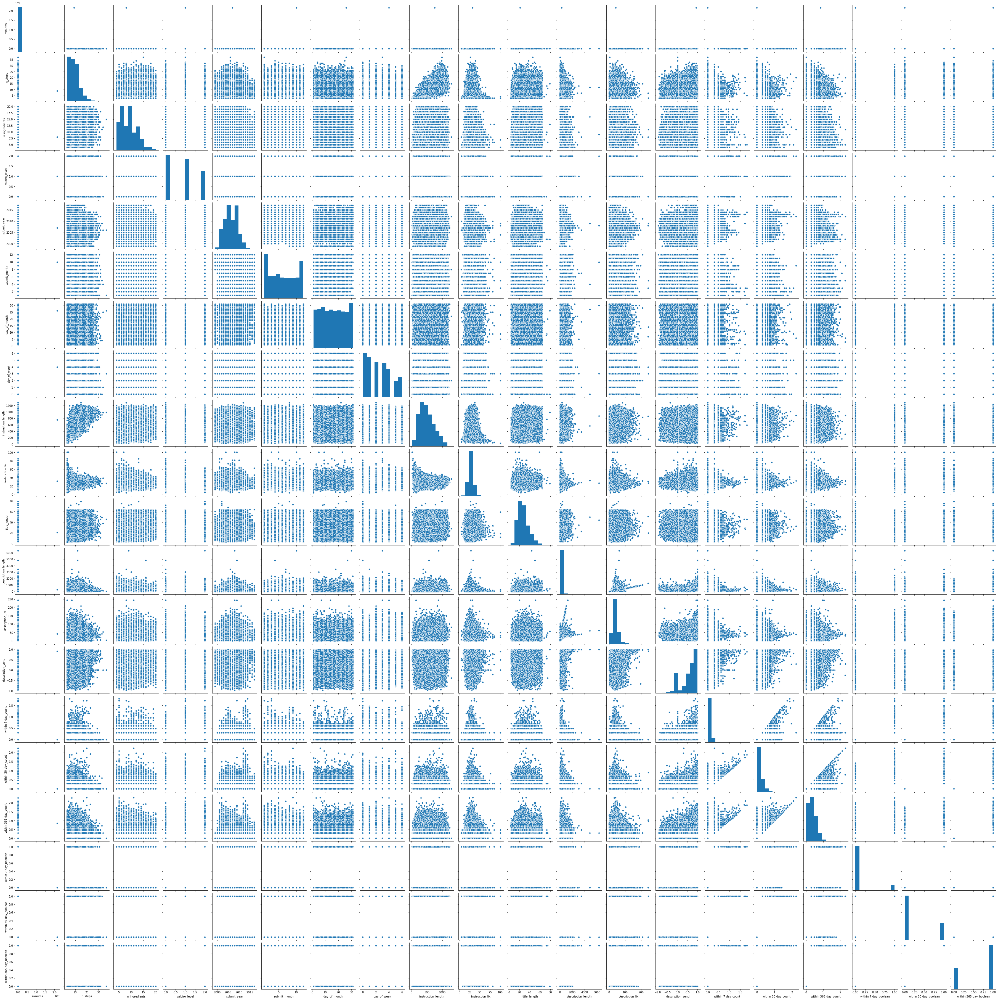

In [38]:
import seaborn as sns
sns.pairplot(model_data_log)

##### Log transform dependent variable

As seen in the pairplot above, the majority of the independt variables skewed too, so log transform are conducted on them as well

In [27]:
## drop n_steps as mentioned above
model_data_log_all = model_data_log.drop(columns=["n_steps"])

# log transform independent variables
numerics = ['minutes', 'n_ingredients', 'instruction_length', 'instruction_lix',
       'title_length', 'description_length', 'description_lix']
for c in numerics:
    model_data_log_all[c] = np.log10(model_data_log_all[c])
model_data_log_all.head()

/opt/anaconda3/envs/py3/lib/python3.7/site-packages/pandas/core/series.py:679: RuntimeWarning:

divide by zero encountered in log10



,minutes,n_ingredients,caloiro_level,submit_year,submit_month,day_of_month,day_of_week,instruction_length,instruction_lix,title_length,description_length,description_lix,description_senti,within 7-day_count,within 30-day_count,within 365-day_count,within 7-day_boolean,within 30-day_boolean,within 365-day_boolean
0,1.740363,0.845098,0.0,2005,9,16,4,2.863917,1.400172,1.623249,2.287802,1.612784,0.0000,0.0,0.0,0.30103,0,0,1
1,1.477121,0.778151,0.0,2002,6,17,0,2.617000,1.472269,1.505150,2.255273,1.682610,0.0000,0.0,0.0,0.30103,0,0,1
2,1.653213,1.041393,1.0,2003,4,14,0,2.761176,1.554012,1.255273,2.367356,1.467677,0.0000,0.0,0.0,0.00000,0,0,0
3,1.176091,0.954243,1.0,2002,4,14,6,2.252853,1.342916,1.322219,2.301030,1.822005,0.8201,0.0,0.0,0.00000,0,0,0
4,1.845098,0.954243,2.0,2003,11,4,1,2.780317,1.365795,1.361728,1.278754,1.560305,0.8221,0.0,0.0,0.30103,0,0,1


In [28]:
# visulize correlations
corr=model_data_log_all.corr()
corr.style.background_gradient()

,minutes,n_ingredients,caloiro_level,submit_year,submit_month,day_of_month,day_of_week,instruction_length,instruction_lix,title_length,description_length,description_lix,description_senti,within 7-day_count,within 30-day_count,within 365-day_count,within 7-day_boolean,within 30-day_boolean,within 365-day_boolean
minutes,1.000000,0.255533,0.172390,-0.039797,0.012919,0.002118,0.006498,0.272170,-0.104794,0.034551,0.056944,0.028537,0.002068,-0.028657,-0.023006,-0.015866,-0.026831,-0.021926,-0.013581
n_ingredients,0.255533,1.000000,0.171696,0.008861,-0.008373,-0.000577,-0.000527,0.377752,-0.093108,0.114159,0.065895,0.042609,0.002580,-0.026216,-0.015603,-0.013299,-0.028442,-0.014519,-0.001450
caloiro_level,0.172390,0.171696,1.000000,-0.021063,0.005018,0.002634,0.005692,0.142756,-0.043963,0.033712,0.014511,-0.005322,0.005923,-0.012096,-0.016224,-0.023986,-0.010703,-0.014986,-0.016152
submit_year,-0.039797,0.008861,-0.021063,1.000000,-0.214039,0.018020,-0.002543,0.060692,0.009423,0.103810,0.158482,0.097221,-0.001119,0.045703,0.060971,0.098814,0.044170,0.061448,0.117324
submit_month,0.012919,-0.008373,0.005018,-0.214039,1.000000,-0.017646,-0.001110,0.001261,-0.016474,-0.013264,0.000814,-0.008196,0.007804,-0.013897,-0.015623,-0.028503,-0.013745,-0.017122,-0.028316
day_of_month,0.002118,-0.000577,0.002634,0.018020,-0.017646,1.000000,0.010726,0.006033,0.001289,0.001716,-0.002332,-0.007593,-0.006124,-0.006576,-0.001761,0.008205,-0.004552,-0.003453,0.004851
day_of_week,0.006498,-0.000527,0.005692,-0.002543,-0.001110,0.010726,1.000000,-0.004174,-0.004435,-0.000646,-0.005046,-0.000115,0.011256,0.005971,0.006905,0.009272,0.007240,0.006835,0.005757
instruction_length,0.272170,0.377752,0.142756,0.060692,0.001261,0.006033,-0.004174,1.000000,-0.130942,0.165463,0.163389,0.101903,0.001629,-0.017946,-0.010604,-0.008996,-0.020487,-0.012239,-0.002548
instruction_lix,-0.104794,-0.093108,-0.043963,0.009423,-0.016474,0.001289,-0.004435,-0.130942,1.000000,0.025480,-0.059736,0.024813,-0.005585,-0.002155,0.000121,-0.006161,-0.002545,0.001505,-0.003285
title_length,0.034551,0.114159,0.033712,0.103810,-0.013264,0.001716,-0.000646,0.165463,0.025480,1.000000,0.113659,0.063075,0.004719,0.002885,0.019624,0.035312,0.001466,0.016049,0.018476


In [29]:
model_data_log_all.describe()

,minutes,n_ingredients,caloiro_level,submit_year,submit_month,day_of_month,day_of_week,instruction_length,instruction_lix,title_length,description_length,description_lix,description_senti,within 7-day_count,within 30-day_count,within 365-day_count,within 7-day_boolean,within 30-day_boolean,within 365-day_boolean
count,9.707600e+04,97076.000000,97076.000000,97076.000000,97076.000000,97076.000000,97076.000000,97076.000000,97076.000000,97076.000000,97076.000000,97076.000000,97076.000000,97076.000000,97076.000000,97076.000000,97076.000000,97076.000000,97076.000000
mean,-inf,0.925520,0.891837,2004.310643,6.169991,15.598613,2.360357,2.637296,1.447269,1.398108,2.113849,1.525079,0.566585,0.035088,0.087172,0.273277,0.106556,0.246838,0.617732
std,NaN,0.157928,0.799048,1.797203,3.452584,8.779175,1.901922,0.222407,0.085915,0.163818,0.361009,0.232058,0.365055,0.105533,0.162271,0.263649,0.308549,0.431174,0.485944
min,-inf,0.602060,0.000000,1999.000000,1.000000,1.000000,0.000000,1.397940,0.646264,0.477121,0.000000,-0.301030,-0.947700,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.361728e+00,0.845098,0.000000,2003.000000,3.000000,8.000000,1.000000,2.494155,1.393374,1.301030,1.897627,1.452298,0.361200,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1.602060e+00,0.954243,1.000000,2005.000000,6.000000,15.000000,2.000000,2.656098,1.449076,1.397940,2.149219,1.551101,0.680800,0.000000,0.000000,0.301030,0.000000,0.000000,1.000000
75%,1.812913e+00,1.041393,2.000000,2006.000000,9.000000,23.000000,4.000000,2.804821,1.503192,1.505150,2.359835,1.653213,0.863625,0.000000,0.000000,0.477121,0.000000,0.000000,1.000000
max,5.061566e+00,1.301030,2.000000,2007.000000,12.000000,31.000000,6.000000,3.084934,2.004321,1.897627,3.536432,2.292572,0.998900,1.414973,1.531479,2.285557,1.000000,1.000000,1.000000


In [30]:
## drop -inf numbers
model_data_log_all = model_data_log_all.replace([np.inf, -np.inf], np.nan)
model_data_log_rm_na = model_data_log_all.dropna()

### 2. Multi-linear Regression

In [67]:
## create function to run multi-linear regression and print results
def multi_linear(df):
    ## split train, test data
    ## use within 365-day_count as target variable
    from sklearn.model_selection import train_test_split
    X_train, X_test, y_train, y_test = train_test_split(df.iloc[:,:-6], df["within 365-day_count"], test_size = 0.20, random_state=5)
    
    ## run multi-linear regression model
    from sklearn.linear_model import LinearRegression
    model = LinearRegression()
    model.fit(X_train, y_train)
    predictions = model.predict(X_test)  
    score = model.score(X_test,y_test)
    print(f"Model Score: {score}")
    
    ## Plot Residuals
    print("Residual Plot:")
    plt.scatter(predictions, predictions - y_test)
    plt.hlines(y=0, xmin=predictions.min(), xmax=predictions.max())
    plt.show()

Model Score: 0.01954177970122284
Residual Plot:


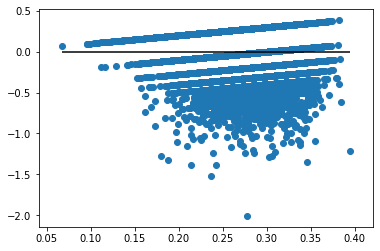

In [68]:
## run multi-linear model
multi_linear(model_data_log_rm_na)

### 3. Random Forest

In [69]:
## create function to run random forest regression and print results
def random_forest(df):
    # Use numpy to convert to arrays
    import numpy as np
    y = np.array(df['within 365-day_count'])
    X = df.iloc[:,:-6]
    
    # Saving feature names for later use
    X_list = list(X.columns)
    
    # Convert to numpy array
    X = np.array(X)
    
    # Split the data into training and testing sets
    from sklearn.model_selection import train_test_split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state=5)
    
    # Import the model we are using
    from sklearn.ensemble import RandomForestRegressor
    
    # Instantiate model 
    rf = RandomForestRegressor(n_estimators= 14, random_state=42,verbose=1)

    # Train the model on training data
    rf.fit(X_train, y_train)
    
    # Use the forest's predict method on the test data
    predictions = rf.predict(X_test)

    from sklearn.metrics import r2_score
#     print(y_test)
#     print(predictions)
    r2_score(y_test, predictions)
    
    print('model score:', r2_score(y_test, predictions))
    
    print("Residual Plot:")
    # Plot Residuals
    plt.scatter(predictions, predictions - y_test)
    plt.hlines(y=0, xmin=predictions.min(), xmax=predictions.max())
    plt.show()

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    7.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished


model score: -0.05772833652374909
Residual Plot:


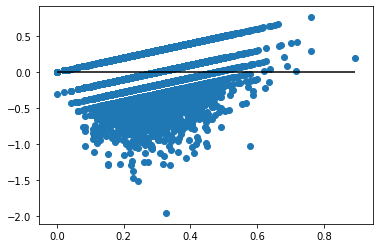

In [70]:
random_forest(model_data_log_rm_na)

### Part III Summary
- Based on the model score and residual plots from both Multi-linear regression and Random Forecast model, it looks neither of them could provide reliable forecast for recipe popularity index using current availabale, which in line with the observation in the correlation matrix, which indicate the recipe popularity index doesn't have strong relationship with any of the independent varaible.
- For further analysis, the best approach will be collecting more data, and/or create more indecies. Also more forecast models can be tried as well.

## Part IV. Classification Model for Boolean of Reviews

In this session, two classification model - Logistic Regression and KNN are used to test if the Popularity of recipes can be forecasted with current available data.

### 1. Logistic Regression

In [74]:
def log_reg(df):
    ## split train, test data
    ## use within 365-day_boolean as target variable
    from sklearn.model_selection import train_test_split
    X_train, X_test, y_train, y_test = train_test_split(df.iloc[:,:-6], df["within 365-day_boolean"], test_size = 0.25, random_state=6)
    
    from sklearn.linear_model import LogisticRegression
    classifier = LogisticRegression()
    
    classifier.fit(X_train, y_train)
    
    print(f"Training Data Score: {classifier.score(X_train, y_train)}")
    print(f"Testing Data Score: {classifier.score(X_test, y_test)}")
    print("----------------------------------------------------------")
    
    predictions_log = classifier.predict(X_test)
    result_log = pd.DataFrame({"Prediction": predictions_log, "Actual": y_test})
    
    print("Result on test data:")
    print(result_log.groupby(["Actual","Prediction"])["Prediction"].count())
    print("----------------------------------------------------------")
    
    # get feature importance
    Log_coef = pd.DataFrame(X_train.columns, columns = ["Variable Name"])
    Log_coef["Coefficient"]=pd.DataFrame(classifier.coef_).transpose()
    print(Log_coef.sort_values("Coefficient"))

In [75]:
log_reg(model_data_log_rm_na)

Training Data Score: 0.6209814107952432
Testing Data Score: 0.6170731707317073
----------------------------------------------------------
Result on test data:
Actual  Prediction
0       0               161
        1              9094
1       0               169
        1             14766
Name: Prediction, dtype: int64
----------------------------------------------------------
         Variable Name  Coefficient
0              minutes    -0.079557
12   description_senti    -0.042516
2        caloiro_level    -0.035864
4         submit_month    -0.016107
7   instruction_length    -0.013270
1        n_ingredients    -0.003846
8      instruction_lix    -0.003532
3          submit_year    -0.000193
5         day_of_month     0.000840
6          day_of_week     0.006251
9         title_length     0.032050
11     description_lix     0.117429
10  description_length     0.453537


/opt/anaconda3/envs/py3/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



#### Logistic Regression Summary
- Testing score is close to Training score, which indicates there is minimal overfitting problem
- Based on the result matrix, the model performce better when the actual value is 1, when it has higher accuracy, while when actual value is 0, the model accuracy is low.
- The coefficient table tells how much impact each measure has in the model. It can be seens that Decription length and lix have the two highest positive impacts, which is kind of surprising, as it indicate the more complicate the description is, the more likely a recipt will be review.

### 2. KNN

In [76]:
def knn_model(df,neighbors):
    ## split train, test data
    ## use within 365-day_boolean as target variable
    from sklearn.model_selection import train_test_split
    X_train, X_test, y_train, y_test = train_test_split(df.iloc[:,:-6], df["within 365-day_boolean"], test_size = 0.25, random_state=6)
    
    
    from sklearn.neighbors import KNeighborsClassifier
    knn = KNeighborsClassifier(n_neighbors=neighbors)
    knn.fit(X_train, y_train)
    print(f'k={neighbors} Trainging Data Score: %.3f' % knn.score(X_train, y_train))
    print(f'k={neighbors} Testing Data Score: %.3f' % knn.score(X_test, y_test))
    print("----------------------------------------------------------")
    
    print("Result on test data:")
    prediction_knn = knn.predict(X_test)
    result_knn = pd.DataFrame({"Prediction": prediction_knn, "Actual": y_test})
    print(result_knn.groupby(["Actual","Prediction"])["Prediction"].count())


In [77]:
knn_model(model_data_log_rm_na,2)

k=2 Trainging Data Score: 0.771
k=2 Testing Data Score: 0.500
----------------------------------------------------------
Result on test data:
Actual  Prediction
0       0             5890
        1             3365
1       0             8742
        1             6193
Name: Prediction, dtype: int64


In [78]:
knn_model(model_data_log_rm_na,5)

k=5 Trainging Data Score: 0.720
k=5 Testing Data Score: 0.574
----------------------------------------------------------
Result on test data:
Actual  Prediction
0       0              2936
        1              6319
1       0              3994
        1             10941
Name: Prediction, dtype: int64


In [79]:
knn_model(model_data_log_rm_na,10)

k=10 Trainging Data Score: 0.672
k=10 Testing Data Score: 0.566
----------------------------------------------------------
Result on test data:
Actual  Prediction
0       0              3218
        1              6037
1       0              4455
        1             10480
Name: Prediction, dtype: int64


In [80]:
knn_model(model_data_log_rm_na,15)

k=15 Trainging Data Score: 0.660
k=15 Testing Data Score: 0.595
----------------------------------------------------------
Result on test data:
Actual  Prediction
0       0              1948
        1              7307
1       0              2498
        1             12437
Name: Prediction, dtype: int64


In [81]:
knn_model(model_data_log_rm_na,20)

k=20 Trainging Data Score: 0.651
k=20 Testing Data Score: 0.594
----------------------------------------------------------
Result on test data:
Actual  Prediction
0       0              2257
        1              6998
1       0              2815
        1             12120
Name: Prediction, dtype: int64


#### KNN Summary
- It looks like 15 is the best number of neighbors to use, because it has the highest testing score
- Even with the best KNN model, testing score of KNN is still lower Comparing to Logistic Regression model
- Based on the result matrix, the KNN model still performce better when the actual value is 1, but accuracy when actual is 0 is a little bit higher comparing to Logistic regression model, although still low.

### Part IV Summary

- Based on the model score and result table from Logistic regression and KNN models, it looks their performes better then regression models, and Logistic Regression is a little better than KNN. However, the accuracy rate still doesn't make them great models for forecasting. 
- Similar to regression, for further analysis, the best approach will be collecting more data, and/or create more indecies. Also more forecast models can be tried as well.


## Appendix - Another attempt to improve the model: split dataset into two

In [90]:
model_data = recipes_df_final.loc[:,['minutes','n_steps', 'n_ingredients', 'caloiro_level', 'submit_year', 'submit_month',
       'day_of_month', 'day_of_week', 'instruction_length', 'instruction_lix',
       'title_length', 'description_length', 'description_lix','description_senti',
       'within 7-day_count', 'within 30-day_count', 'within 365-day_count',
       'within 7-day_boolean', 'within 30-day_boolean',
       'within 365-day_boolean']]
model_data_rm_na = model_data.dropna()

## split data into two groups: within 365-day_count< 5 and within 365-day_count >5
## 5 is the upper limit in the boxplot
data_group_1 = model_data_rm_na.loc[model_data_rm_na["within 365-day_count"]<=5,:]
data_group_1.info()
data_group_2 = model_data_rm_na.loc[model_data_rm_na["within 365-day_count"]>5,:]
data_group_2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 93803 entries, 0 to 97075
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   minutes                 93803 non-null  int64  
 1   n_steps                 93803 non-null  int64  
 2   n_ingredients           93803 non-null  int64  
 3   caloiro_level           93803 non-null  float64
 4   submit_year             93803 non-null  int64  
 5   submit_month            93803 non-null  int64  
 6   day_of_month            93803 non-null  int64  
 7   day_of_week             93803 non-null  int64  
 8   instruction_length      93803 non-null  int64  
 9   instruction_lix         93803 non-null  float64
 10  title_length            93803 non-null  int64  
 11  description_length      93803 non-null  int64  
 12  description_lix         93803 non-null  float64
 13  description_senti       93803 non-null  float64
 14  within 7-day_count      93803 non-null

In [91]:
## Group 1
# log transform dependent variables
data_group_1_log = data_group_1.loc[:,:]
numerics = ['within 365-day_count']
for c in numerics:
    data_group_1_log[c] = np.log10(data_group_1_log[c]+1)
data_group_1_log.head()

# log transform independent variables
data_group_1_log_all = data_group_1_log.loc[:,:]
numerics = ['minutes','n_steps', 'n_ingredients', 'instruction_length', 'instruction_lix',
       'title_length', 'description_length', 'description_lix']
for c in numerics:
    data_group_1_log_all[c] = np.log10(data_group_1_log_all[c])
data_group_1_log_all.head()


/opt/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,minutes,n_steps,n_ingredients,caloiro_level,submit_year,submit_month,day_of_month,day_of_week,instruction_length,instruction_lix,title_length,description_length,description_lix,description_senti,within 7-day_count,within 30-day_count,within 365-day_count,within 7-day_boolean,within 30-day_boolean,within 365-day_boolean
0,1.740363,1.041393,0.845098,0.0,2005,9,16,4,2.863917,1.400172,1.623249,2.287802,1.612784,0.0000,0,0,0.30103,0,0,1
1,1.477121,0.954243,0.778151,0.0,2002,6,17,0,2.617000,1.472269,1.505150,2.255273,1.682610,0.0000,0,0,0.30103,0,0,1
2,1.653213,1.041393,1.041393,1.0,2003,4,14,0,2.761176,1.554012,1.255273,2.367356,1.467677,0.0000,0,0,0.00000,0,0,0
3,1.176091,0.602060,0.954243,1.0,2002,4,14,6,2.252853,1.342916,1.322219,2.301030,1.822005,0.8201,0,0,0.00000,0,0,0
4,1.845098,1.079181,0.954243,2.0,2003,11,4,1,2.780317,1.365795,1.361728,1.278754,1.560305,0.8221,0,0,0.30103,0,0,1


In [92]:
# visulize correlations
corr=data_group_1_log_all.corr()
corr.style.background_gradient()

,minutes,n_steps,n_ingredients,caloiro_level,submit_year,submit_month,day_of_month,day_of_week,instruction_length,instruction_lix,title_length,description_length,description_lix,description_senti,within 7-day_count,within 30-day_count,within 365-day_count,within 7-day_boolean,within 30-day_boolean,within 365-day_boolean
minutes,1.000000,0.270045,0.256060,0.169974,-0.035410,0.012963,0.002047,0.006895,0.274909,-0.104571,0.033029,0.058295,0.029291,0.002413,-0.027771,-0.021919,-0.016673,-0.026351,-0.022291,-0.013295
n_steps,0.270045,1.000000,0.354816,0.137784,0.048071,0.006116,0.005634,-0.001102,0.854427,-0.066968,0.117688,0.083540,0.068952,-0.000046,-0.021801,-0.022022,-0.026533,-0.023069,-0.023154,-0.017993
n_ingredients,0.256060,0.354816,1.000000,0.169735,0.009312,-0.008609,-0.001464,-0.001193,0.378297,-0.093475,0.114907,0.066482,0.043577,0.003797,-0.025569,-0.013255,-0.007409,-0.027272,-0.011936,0.000550
caloiro_level,0.169974,0.137784,0.169735,1.000000,-0.018862,0.005933,0.002603,0.005283,0.142011,-0.043446,0.034167,0.015453,-0.004669,0.006349,-0.010277,-0.013011,-0.019106,-0.009186,-0.012738,-0.014259
submit_year,-0.035410,0.048071,0.009312,-0.018862,1.000000,-0.213882,0.019107,-0.001754,0.060555,0.008872,0.103857,0.157890,0.096952,-0.000213,0.043982,0.058414,0.111002,0.043500,0.061186,0.118485
submit_month,0.012963,0.006116,-0.008609,0.005933,-0.213882,1.000000,-0.018539,-0.000255,0.001437,-0.016848,-0.013662,0.000797,-0.008844,0.006451,-0.013637,-0.012362,-0.028340,-0.013255,-0.015762,-0.027767
day_of_month,0.002047,0.005634,-0.001464,0.002603,0.019107,-0.018539,1.000000,0.010340,0.006053,0.001067,0.003577,-0.003427,-0.008928,-0.005525,-0.005680,-0.000075,0.007940,-0.004455,-0.003602,0.004529
day_of_week,0.006895,-0.001102,-0.001193,0.005283,-0.001754,-0.000255,0.010340,1.000000,-0.003524,-0.004447,-0.000447,-0.005634,-0.000592,0.012624,0.005964,0.005692,0.007397,0.006019,0.004742,0.004981
instruction_length,0.274909,0.854427,0.378297,0.142011,0.060555,0.001437,0.006053,-0.003524,1.000000,-0.130497,0.166088,0.161685,0.102248,0.001673,-0.018026,-0.008293,-0.005317,-0.019546,-0.010616,-0.001141
instruction_lix,-0.104571,-0.066968,-0.093475,-0.043446,0.008872,-0.016848,0.001067,-0.004447,-0.130497,1.000000,0.026241,-0.059180,0.024783,-0.006097,-0.000182,0.004470,-0.002661,-0.002158,0.003809,-0.002353


In [93]:
## Group 2

# log transform dependent variable
data_group_2_log = data_group_2.loc[:,:]
numerics = ['within 365-day_count']
for c in numerics:
    data_group_2_log[c] = np.log10(data_group_2_log[c])
data_group_2_log.head()

# log transform independent variables
data_group_2_log_all = data_group_2_log.loc[:,:]
numerics = ['minutes','n_steps', 'n_ingredients', 'instruction_length', 'instruction_lix',
       'title_length', 'description_length', 'description_lix']
for c in numerics:
    data_group_2_log_all[c] = np.log10(data_group_2_log_all[c])
data_group_2_log_all.head()


/opt/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,minutes,n_steps,n_ingredients,caloiro_level,submit_year,submit_month,day_of_month,day_of_week,instruction_length,instruction_lix,title_length,description_length,description_lix,description_senti,within 7-day_count,within 30-day_count,within 365-day_count,within 7-day_boolean,within 30-day_boolean,within 365-day_boolean
28,1.255273,0.903090,0.903090,2.0,2004,5,10,0,2.694605,1.236789,1.623249,2.600973,1.757929,0.9757,0,3,0.778151,0,1,1
38,1.544068,0.845098,0.778151,2.0,2002,3,14,3,2.563481,1.381215,1.414973,2.409933,1.494464,0.6996,0,0,0.778151,0,0,1
58,2.079181,0.602060,1.041393,0.0,2005,1,19,2,2.404834,1.395035,1.602060,2.255273,1.429667,0.2340,1,1,0.778151,1,1,1
71,1.954243,1.079181,1.000000,2.0,2003,5,17,5,2.808886,1.473608,1.602060,2.586587,1.728354,-0.2263,1,1,0.778151,1,1,1
79,1.602060,0.845098,0.954243,2.0,2002,9,15,6,2.471292,1.236236,1.000000,2.281033,1.757718,0.5399,0,2,0.778151,0,1,1


In [94]:
# visulize correlations
corr=data_group_2_log_all.corr()
corr.style.background_gradient()

/opt/anaconda3/envs/py3/lib/python3.7/site-packages/matplotlib/colors.py:527: RuntimeWarning:

invalid value encountered in less

/opt/anaconda3/envs/py3/lib/python3.7/site-packages/pandas/io/formats/style.py:1089: RuntimeWarning:

All-NaN slice encountered

/opt/anaconda3/envs/py3/lib/python3.7/site-packages/pandas/io/formats/style.py:1090: RuntimeWarning:

All-NaN slice encountered



,minutes,n_steps,n_ingredients,caloiro_level,submit_year,submit_month,day_of_month,day_of_week,instruction_length,instruction_lix,title_length,description_length,description_lix,description_senti,within 7-day_count,within 30-day_count,within 365-day_count,within 7-day_boolean,within 30-day_boolean,within 365-day_boolean
minutes,1.000000,0.193079,0.240202,0.239691,-0.160766,0.010575,0.004470,-0.003852,0.195768,-0.112018,0.080432,0.029093,0.007714,-0.008030,-0.033033,-0.041741,0.019798,-0.030507,0.000156,nan
n_steps,0.193079,1.000000,0.342463,0.157902,0.030929,-0.013316,0.015690,-0.015542,0.857100,-0.094234,0.094247,0.125079,0.038816,-0.010227,0.022699,0.002581,0.011796,-0.022491,-0.021241,nan
n_ingredients,0.240202,0.342463,1.000000,0.223630,0.001528,-0.005237,0.025909,0.021220,0.359971,-0.085716,0.103955,0.074464,0.019469,-0.033476,0.044369,0.006094,-0.012936,-0.019796,-0.015603,nan
caloiro_level,0.239691,0.157902,0.223630,1.000000,-0.080581,-0.026372,0.004998,0.020962,0.160875,-0.062595,0.032341,0.013625,-0.018459,-0.008995,0.011510,0.000873,-0.005204,0.003440,0.004045,nan
submit_year,-0.160766,0.030929,0.001528,-0.080581,1.000000,-0.215788,-0.015212,-0.028766,0.069125,0.028481,0.093262,0.160274,0.099637,-0.024734,0.060065,0.046916,-0.084785,0.030618,0.024625,nan
submit_month,0.010575,-0.013316,-0.005237,-0.026372,-0.215788,1.000000,0.009167,-0.024656,-0.006453,-0.007446,0.004821,0.016319,0.018262,0.044728,-0.005735,0.001510,-0.006774,-0.001311,-0.012958,nan
day_of_month,0.004470,0.015690,0.025909,0.004998,-0.015212,0.009167,1.000000,0.021527,0.006348,0.008311,-0.054591,0.024469,0.034724,-0.022561,-0.042279,-0.012177,-0.000373,-0.016552,-0.018554,nan
day_of_week,-0.003852,-0.015542,0.021220,0.020962,-0.028766,-0.024656,0.021527,1.000000,-0.021400,-0.002825,-0.011151,0.001604,0.012294,-0.026879,-0.017245,-0.005344,-0.003348,0.013760,0.032042,nan
instruction_length,0.195768,0.857100,0.359971,0.160875,0.069125,-0.006453,0.006348,-0.021400,1.000000,-0.146022,0.156301,0.237075,0.097603,-0.001247,0.039732,0.017836,0.018289,-0.015860,-0.007398,nan
instruction_lix,-0.112018,-0.094234,-0.085716,-0.062595,0.028481,-0.007446,0.008311,-0.002825,-0.146022,1.000000,0.008683,-0.067428,0.029960,0.007707,-0.005011,-0.024058,-0.024290,0.009209,-0.020837,nan


In [95]:
data_group_1_log_all = data_group_1_log_all.replace([np.inf, -np.inf], np.nan)
data_group_1_rm_na = data_group_1_log_all.dropna()

In [96]:
data_group_2_log_all = data_group_2_log_all.replace([np.inf, -np.inf], np.nan)
data_group_2_rm_na = data_group_2_log_all.dropna()

Model Score: 0.018302034820953272
Residual Plot:


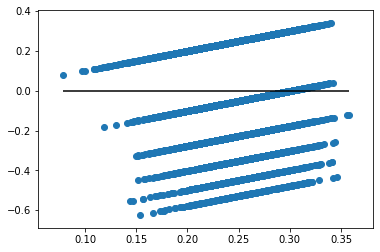

In [97]:
## run multi-linear model on group 1
multi_linear(data_group_1_rm_na)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    7.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished


model score: -0.06643675088918699
Residual Plot:


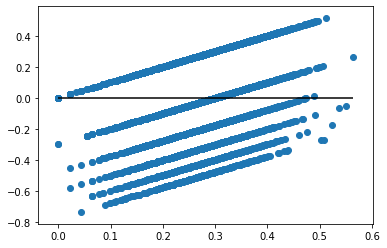

In [98]:
## run random forest model on group 1
random_forest(data_group_1_rm_na)

In [101]:
## run logistic regression model on group 1
log_reg(data_group_1_rm_na)

Training Data Score: 0.6072024531127433
Testing Data Score: 0.6074362485024816
----------------------------------------------------------
Result on test data:
Actual  Prediction
0       0               103
        1              9103
1       0                72
        1             14094
Name: Prediction, dtype: int64
----------------------------------------------------------
         Variable Name  Coefficient
3        caloiro_level    -0.078676
0              minutes    -0.056379
1              n_steps    -0.039413
13   description_senti    -0.022878
5         submit_month    -0.017495
8   instruction_length    -0.004944
7          day_of_week    -0.003954
2        n_ingredients    -0.003806
9      instruction_lix    -0.001263
4          submit_year    -0.000017
6         day_of_month     0.000155
10        title_length     0.025781
12     description_lix     0.080037
11  description_length     0.309604


In [102]:
## run KNN  model on group 1
knn_model(data_group_1_rm_na,15)

k=15 Trainging Data Score: 0.651
k=15 Testing Data Score: 0.585
----------------------------------------------------------
Result on test data:
Actual  Prediction
0       0              2194
        1              7012
1       0              2690
        1             11476
Name: Prediction, dtype: int64


model score: 0.01579495644544815
Residual Plot:


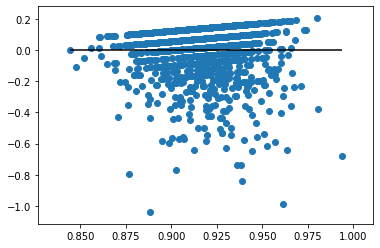

In [229]:
## run multi-linear model on group 2
multi_linear(data_group_2_rm_na)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


model score: -0.0846586065056456
Residual Plot:


[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.0s finished


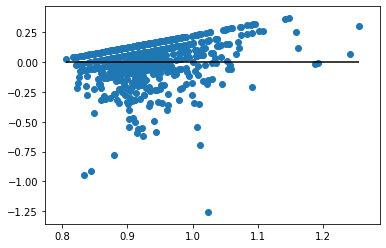

In [99]:
## run random forest model on group 1
random_forest(data_group_2_rm_na)